In [1]:
import os
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots

import folium

import pandas as pd 

import matplotlib.pyplot as plt 

%matplotlib inline

import math
import random
from datetime import timedelta 

#color pallette 
cnf = '#393e46'
dth = '#ff2e63'
rec = '#21bf73'
act = '#fe9801'

In [2]:
import plotly as py 
py.offline.init_notebook_mode(connected = True)

In [3]:
df = pd.read_csv('covid_19_data_cleaned.csv',parse_dates=['Date'])

In [4]:
df['Province/State'] = df['Province/State'].fillna("")
df.head()

,Date,Province/State,Country,Lat,Long,Confirmed,Recovered,Deaths,Active
0,2020-01-22,,Afghanistan,33.93911,67.709953,0,0,0,0
1,2020-01-23,,Afghanistan,33.93911,67.709953,0,0,0,0
2,2020-01-24,,Afghanistan,33.93911,67.709953,0,0,0,0
3,2020-01-25,,Afghanistan,33.93911,67.709953,0,0,0,0
4,2020-01-26,,Afghanistan,33.93911,67.709953,0,0,0,0


In [6]:
df

,Date,Province/State,Country,Lat,Long,Confirmed,Recovered,Deaths,Active
0,2020-01-22,,Afghanistan,33.93911,67.709953,0,0,0,0
1,2020-01-23,,Afghanistan,33.93911,67.709953,0,0,0,0
2,2020-01-24,,Afghanistan,33.93911,67.709953,0,0,0,0
3,2020-01-25,,Afghanistan,33.93911,67.709953,0,0,0,0
4,2020-01-26,,Afghanistan,33.93911,67.709953,0,0,0,0
...,...,...,...,...,...,...,...,...,...
210491,2022-01-22,,Timor-Leste,-8.87420,125.727500,0,0,0,0
210492,2022-01-23,,Timor-Leste,-8.87420,125.727500,0,0,0,0
210493,2022-01-24,,Timor-Leste,-8.87420,125.727500,0,0,0,0
210494,2022-01-25,,Timor-Leste,-8.87420,125.727500,0,0,0,0


In [7]:
confirmed = df.groupby('Date').sum()['Confirmed'].reset_index()
confirmed


,Date,Confirmed
0,2020-01-22,557
1,2020-01-23,655
2,2020-01-24,941
3,2020-01-25,1434
4,2020-01-26,2118
...,...,...
731,2022-01-22,349129702
732,2022-01-23,351523268
733,2022-01-24,354990003
734,2022-01-25,358660421


In [8]:
recovered = df.groupby('Date').sum()['Recovered'].reset_index()
recovered

,Date,Recovered
0,2020-01-22,30
1,2020-01-23,32
2,2020-01-24,39
3,2020-01-25,42
4,2020-01-26,56
...,...,...
731,2022-01-22,0
732,2022-01-23,0
733,2022-01-24,0
734,2022-01-25,0


In [9]:
deaths = df.groupby('Date').sum()['Deaths'].reset_index()
deaths

,Date,Deaths
0,2020-01-22,17
1,2020-01-23,18
2,2020-01-24,26
3,2020-01-25,42
4,2020-01-26,56
...,...,...
731,2022-01-22,5592206
732,2022-01-23,5597006
733,2022-01-24,5605459
734,2022-01-25,5615868


In [10]:
df.isnull().sum()

Date              0
Province/State    0
Country           0
Lat               0
Long              0
Confirmed         0
Recovered         0
Deaths            0
Active            0
dtype: int64

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 210496 entries, 0 to 210495
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   Date            210496 non-null  datetime64[ns]
 1   Province/State  210496 non-null  object        
 2   Country         210496 non-null  object        
 3   Lat             210496 non-null  float64       
 4   Long            210496 non-null  float64       
 5   Confirmed       210496 non-null  int64         
 6   Recovered       210496 non-null  int64         
 7   Deaths          210496 non-null  int64         
 8   Active          210496 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(4), object(2)
memory usage: 14.5+ MB


In [12]:
df.query('Country == "US"')

,Date,Province/State,Country,Lat,Long,Confirmed,Recovered,Deaths,Active
187680,2020-01-22,,US,40.0,-100.0,1,0,0,1
187681,2020-01-23,,US,40.0,-100.0,1,0,0,1
187682,2020-01-24,,US,40.0,-100.0,2,0,0,2
187683,2020-01-25,,US,40.0,-100.0,2,0,0,2
187684,2020-01-26,,US,40.0,-100.0,5,0,0,5
...,...,...,...,...,...,...,...,...,...
188411,2022-01-22,,US,40.0,-100.0,70490987,0,866470,69624517
188412,2022-01-23,,US,40.0,-100.0,70845794,0,867042,69978752
188413,2022-01-24,,US,40.0,-100.0,71741698,0,869026,70872672
188414,2022-01-25,,US,40.0,-100.0,72257016,0,872025,71384991


In [14]:
df.query('Country == "Algeria"')

,Date,Province/State,Country,Lat,Long,Confirmed,Recovered,Deaths,Active
1472,2020-01-22,,Algeria,28.0339,1.6596,0,0,0,0
1473,2020-01-23,,Algeria,28.0339,1.6596,0,0,0,0
1474,2020-01-24,,Algeria,28.0339,1.6596,0,0,0,0
1475,2020-01-25,,Algeria,28.0339,1.6596,0,0,0,0
1476,2020-01-26,,Algeria,28.0339,1.6596,0,0,0,0
...,...,...,...,...,...,...,...,...,...
2203,2022-01-22,,Algeria,28.0339,1.6596,234536,0,6481,228055
2204,2022-01-23,,Algeria,28.0339,1.6596,236670,0,6495,230175
2205,2022-01-24,,Algeria,28.0339,1.6596,238885,0,6508,232377
2206,2022-01-25,,Algeria,28.0339,1.6596,241406,0,6516,234890


In [15]:
confirmed.head()

,Date,Confirmed
0,2020-01-22,557
1,2020-01-23,655
2,2020-01-24,941
3,2020-01-25,1434
4,2020-01-26,2118


In [16]:
confirmed.tail()

,Date,Confirmed
731,2022-01-22,349129702
732,2022-01-23,351523268
733,2022-01-24,354990003
734,2022-01-25,358660421
735,2022-01-26,362130423


In [17]:
recovered.head()

,Date,Recovered
0,2020-01-22,30
1,2020-01-23,32
2,2020-01-24,39
3,2020-01-25,42
4,2020-01-26,56


In [20]:
recovered.tail()

,Date,Recovered
731,2022-01-22,0
732,2022-01-23,0
733,2022-01-24,0
734,2022-01-25,0
735,2022-01-26,0


In [21]:
deaths.head()

,Date,Deaths
0,2020-01-22,17
1,2020-01-23,18
2,2020-01-24,26
3,2020-01-25,42
4,2020-01-26,56


In [22]:
deaths.tail()

,Date,Deaths
731,2022-01-22,5592206
732,2022-01-23,5597006
733,2022-01-24,5605459
734,2022-01-25,5615868
735,2022-01-26,5626091


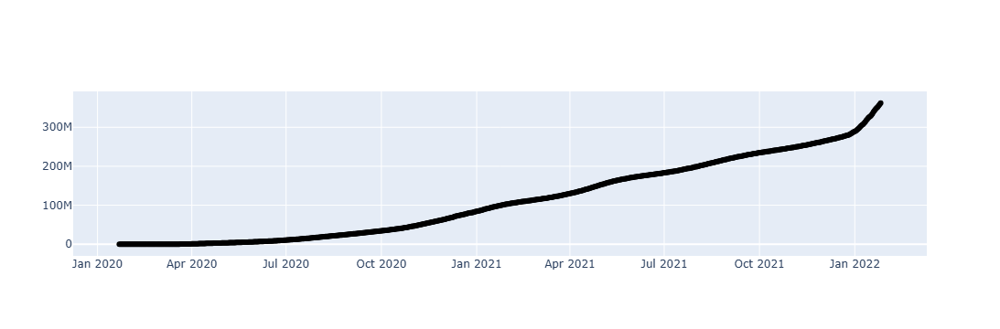

In [18]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = confirmed['Date'], y = confirmed['Confirmed'], mode = 'lines+markers', name = 'Confirmed', line = dict(color = "Black", width = 1)))
fig.show()

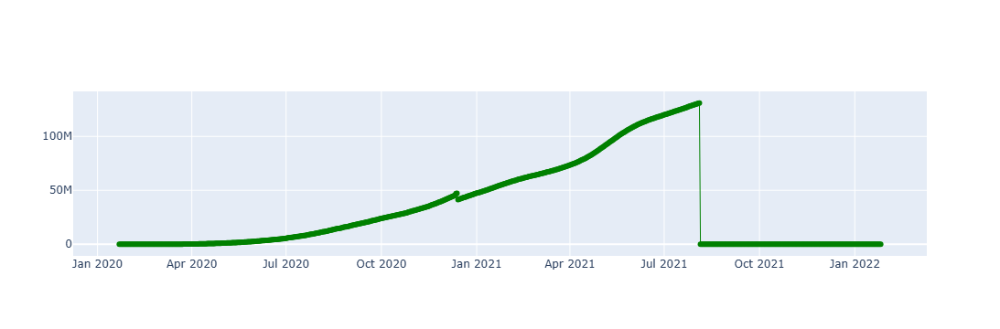

In [19]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = recovered['Date'], y = recovered['Recovered'], mode = 'lines+markers', name = 'Recovered', line = dict(color = "Green", width = 1)))
fig.show()

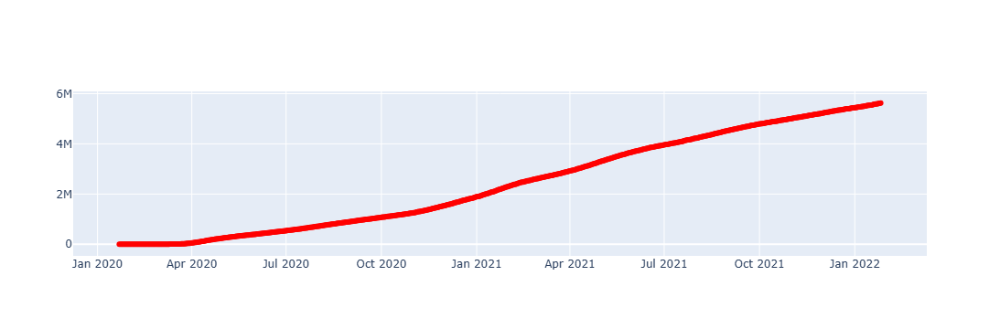

In [20]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = deaths['Date'], y = deaths['Deaths'], mode = 'lines+markers', name = 'Deaths', line = dict(color = "Red", width = 1)))
fig.show()

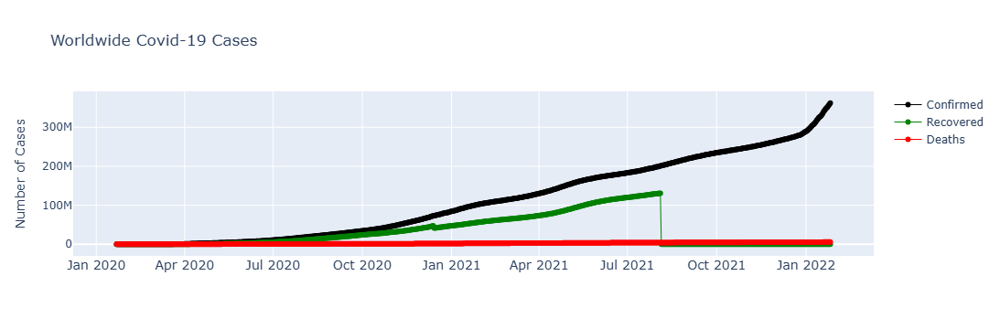

In [21]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = confirmed['Date'], y = confirmed['Confirmed'], mode = 'lines+markers', name = 'Confirmed', line = dict(color = "Black", width = 1)))
fig.add_trace(go.Scatter(x = recovered['Date'], y = recovered['Recovered'], mode = 'lines+markers', name = 'Recovered', line = dict(color = "Green", width = 1)))
fig.add_trace(go.Scatter(x = deaths['Date'], y = deaths['Deaths'], mode = 'lines+markers', name = 'Deaths', line = dict(color = "Red", width = 1)))
fig.update_layout(title = 'Worldwide Covid-19 Cases', xaxis_tickfont_size = 14, yaxis = dict(title = 'Number of Cases'))
fig.show()

In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 210496 entries, 0 to 210495
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   Date            210496 non-null  datetime64[ns]
 1   Province/State  210496 non-null  object        
 2   Country         210496 non-null  object        
 3   Lat             210496 non-null  float64       
 4   Long            210496 non-null  float64       
 5   Confirmed       210496 non-null  int64         
 6   Recovered       210496 non-null  int64         
 7   Deaths          210496 non-null  int64         
 8   Active          210496 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(4), object(2)
memory usage: 14.5+ MB


In [28]:
df.head()

,Date,Province/State,Country,Lat,Long,Confirmed,Recovered,Deaths,Active
0,2020-01-22,,Afghanistan,33.93911,67.709953,0,0,0,0
1,2020-01-23,,Afghanistan,33.93911,67.709953,0,0,0,0
2,2020-01-24,,Afghanistan,33.93911,67.709953,0,0,0,0
3,2020-01-25,,Afghanistan,33.93911,67.709953,0,0,0,0
4,2020-01-26,,Afghanistan,33.93911,67.709953,0,0,0,0


C:\Users\EVO\AppData\Local\Temp\ipykernel_99524\1690399167.py:1: DeprecationWarning:

*density_mapbox* is deprecated! Use *density_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



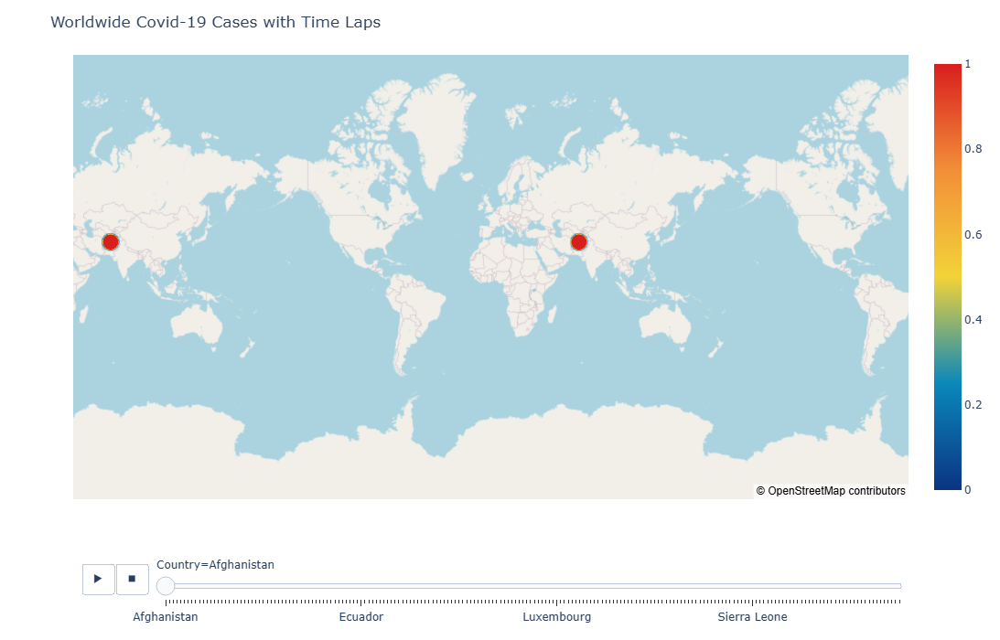

In [22]:
fig = px.density_mapbox(df, lat = 'Lat', lon= 'Long', hover_name = 'Country', hover_data = ['Confirmed', 'Recovered', 'Deaths'], animation_frame='Country', color_continuous_scale='Portland', radius = 7, zoom = 0, height=700)
fig.update_layout(title = 'Worldwide Covid-19 Cases with Time Laps')
fig.update_layout(mapbox_style = 'open-street-map', mapbox_center_lon = 0)

fig.show()